# Transform 이해하기

In [1]:
import os
from glob import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline

##### 디바이스 설정

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [12]:
image = Image.open('./dataset/sample.jpg')
np.array(image).shape

(1335, 2000, 3)

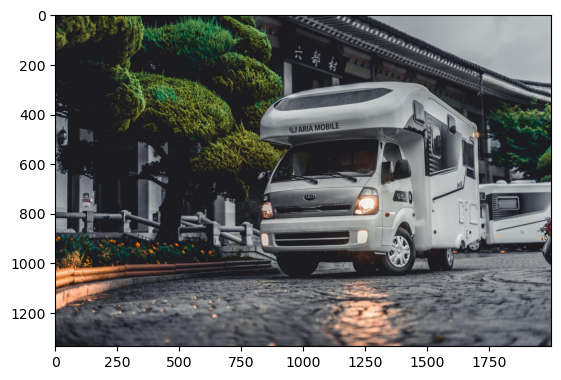

In [13]:
plt.imshow(image)
plt.show()

transform의 다양한 기능들

In [14]:
dir(transforms)

['AugMix',
 'AutoAugment',
 'AutoAugmentPolicy',
 'CenterCrop',
 'ColorJitter',
 'Compose',
 'ConvertImageDtype',
 'ElasticTransform',
 'FiveCrop',
 'GaussianBlur',
 'Grayscale',
 'InterpolationMode',
 'Lambda',
 'LinearTransformation',
 'Normalize',
 'PILToTensor',
 'Pad',
 'RandAugment',
 'RandomAdjustSharpness',
 'RandomAffine',
 'RandomApply',
 'RandomAutocontrast',
 'RandomChoice',
 'RandomCrop',
 'RandomEqualize',
 'RandomErasing',
 'RandomGrayscale',
 'RandomHorizontalFlip',
 'RandomInvert',
 'RandomOrder',
 'RandomPerspective',
 'RandomPosterize',
 'RandomResizedCrop',
 'RandomRotation',
 'RandomSolarize',
 'RandomVerticalFlip',
 'Resize',
 'TenCrop',
 'ToPILImage',
 'ToTensor',
 'TrivialAugmentWide',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '_functional_pil',
 '_functional_tensor',
 '_presets',
 'autoaugment',
 'functional',
 'transforms']

### Transform on Tensor

리사이징

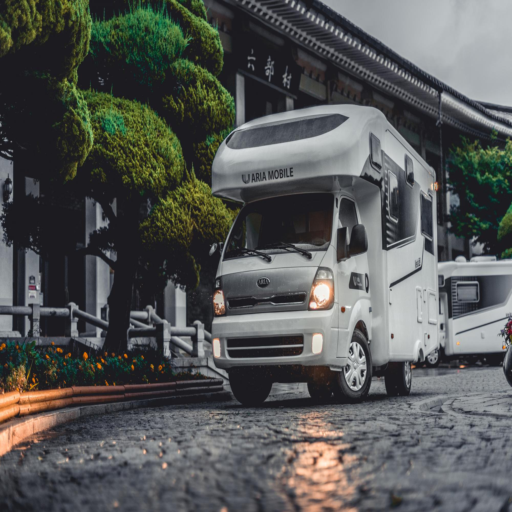

In [15]:
transforms.Resize((512, 512))(image)

랜덤으로 사진 부분 자르기, 데이터 증강에 쓰임?

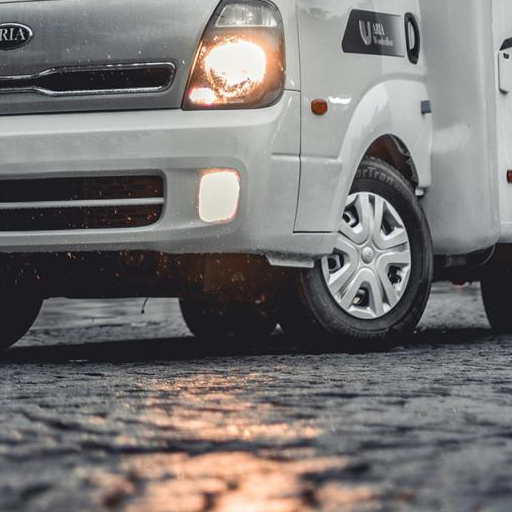

In [17]:
transforms.RandomCrop(size=(512,512))(image)

밝기 랜덤 조정

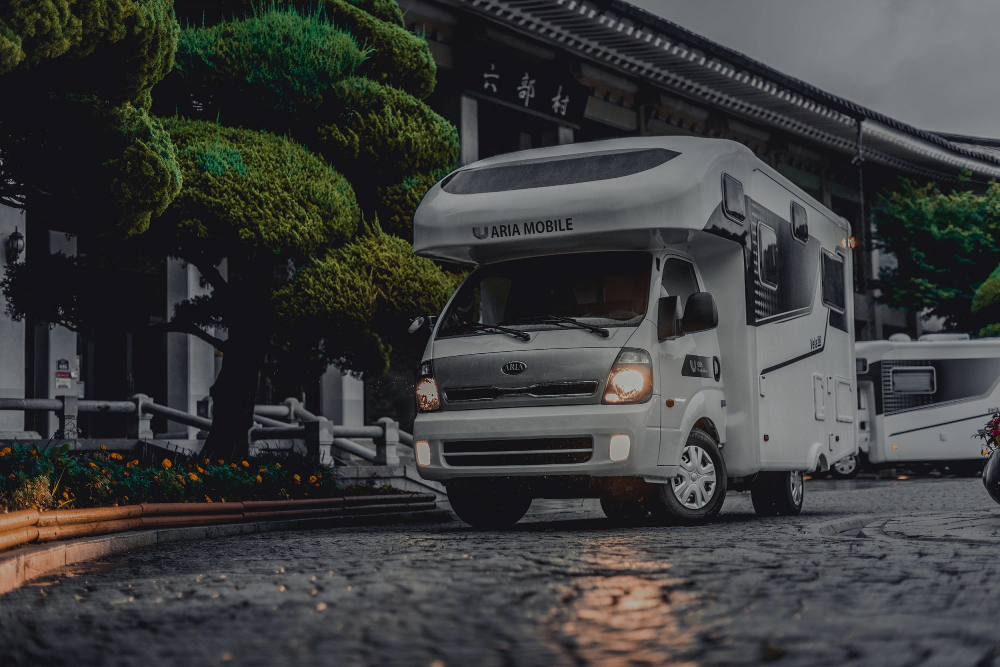

In [18]:
transforms.ColorJitter(brightness=1)(image)

이미지 회색화

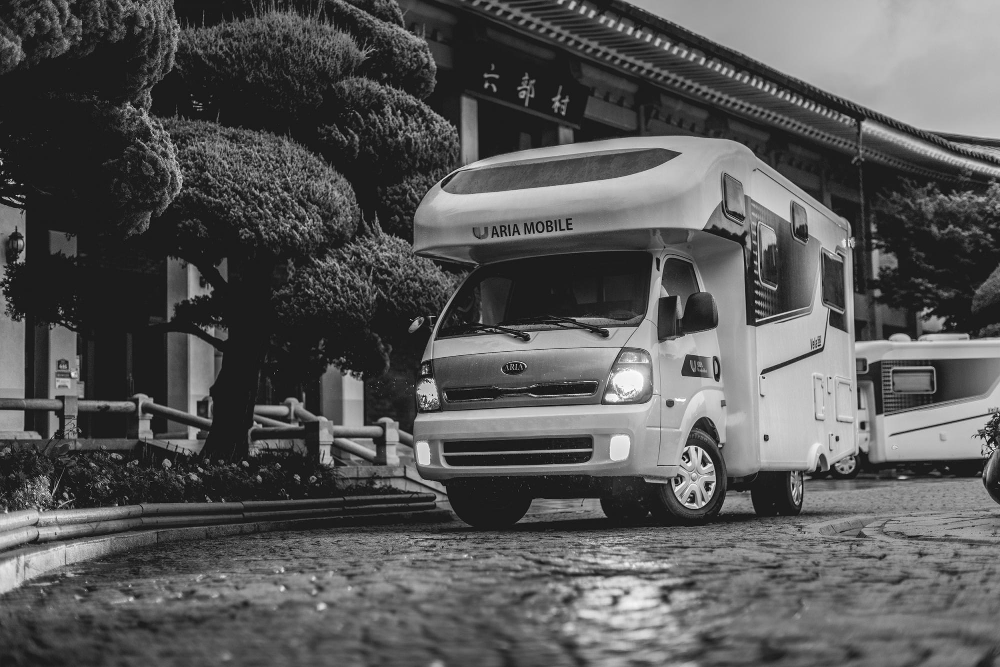

In [19]:
transforms.Grayscale()(image)

패딩

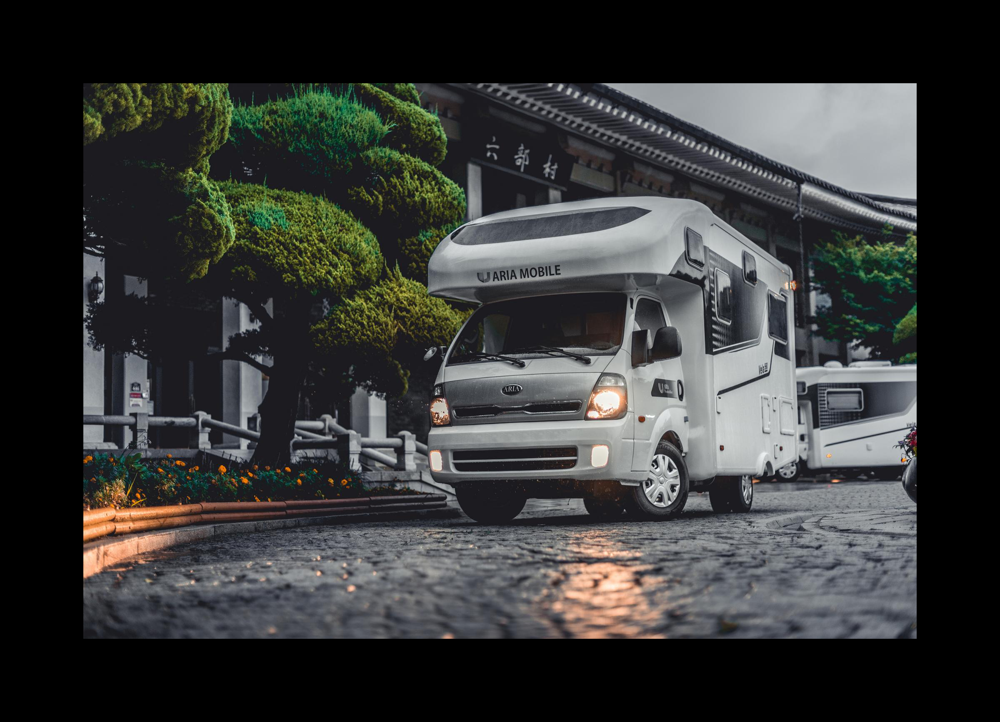

In [21]:
transforms.Pad(padding=(200,200))(image)

진짜 중요하고 많이 사용하는 작업 : 사진회전

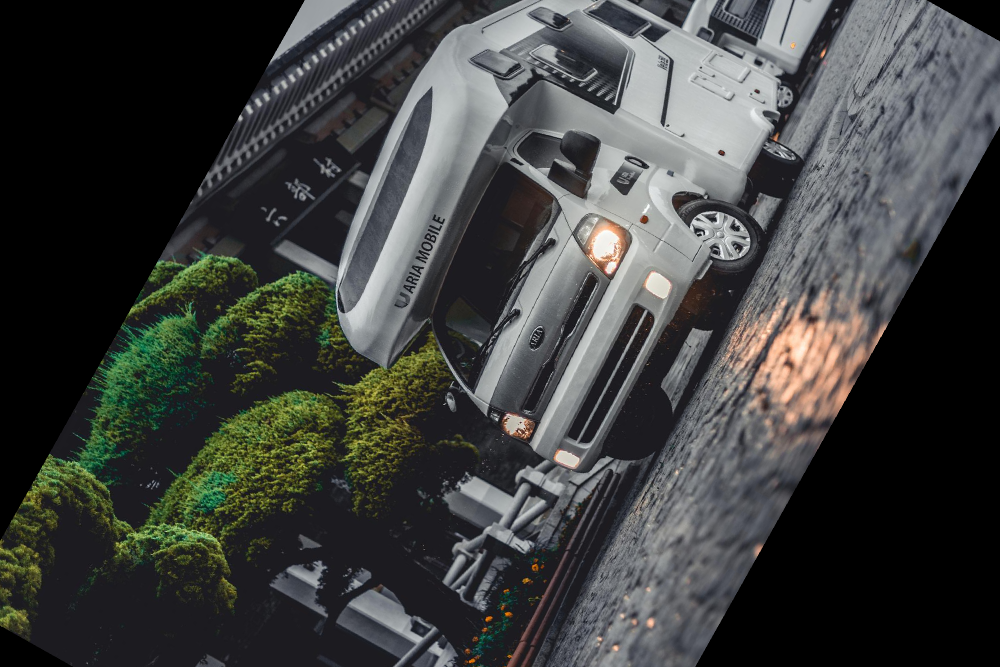

In [22]:
transforms.RandomAffine(degrees=90)(image) # 90 이내에 랜덤 각도로 회전

리스트로 많은 작업을 한번에 지정할수 있다.

In [23]:
transforms_list = [
    transforms.RandomAffine(degrees=90),
    transforms.Pad(padding=(100,300)),
    transforms.Grayscale()
]

또, 리스트 내에서 랜덤하게 실행시킬수도 있다.!!!!!

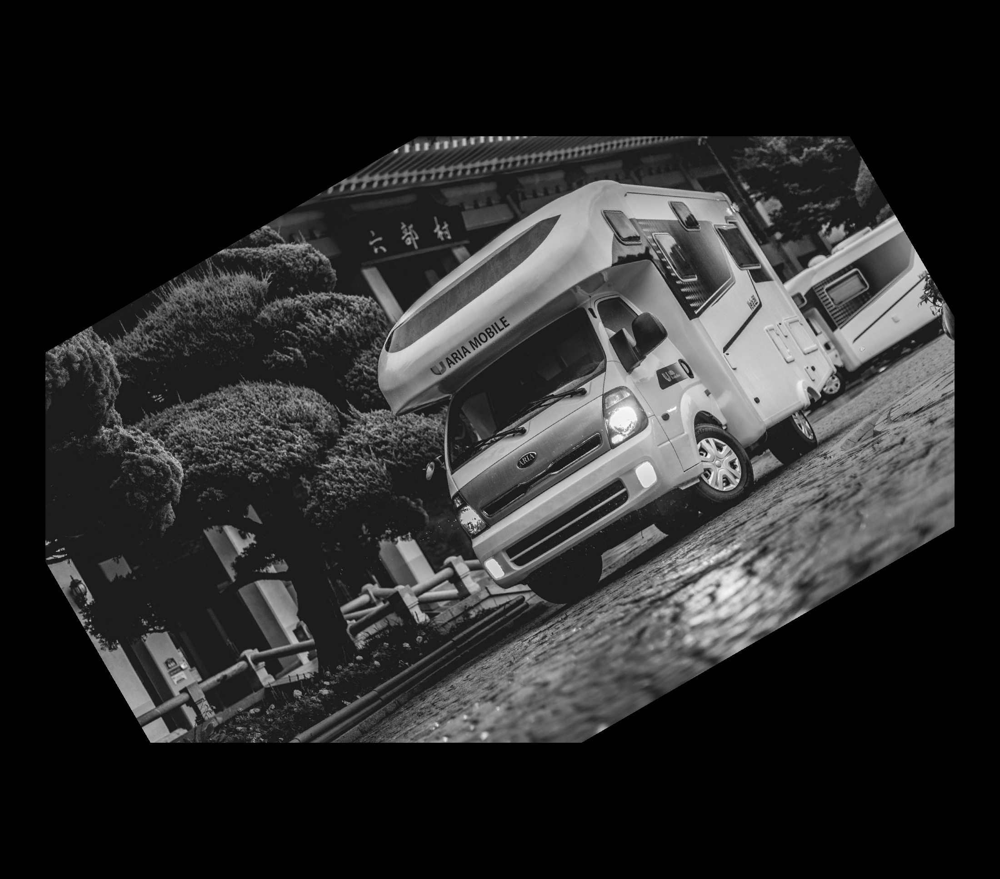

In [24]:
transforms.RandomApply(transforms_list, p=0.5)(image) # p는 확률값 0.5는 반반

리스트 내에서 랜덤하게 하나만 초이스 해라

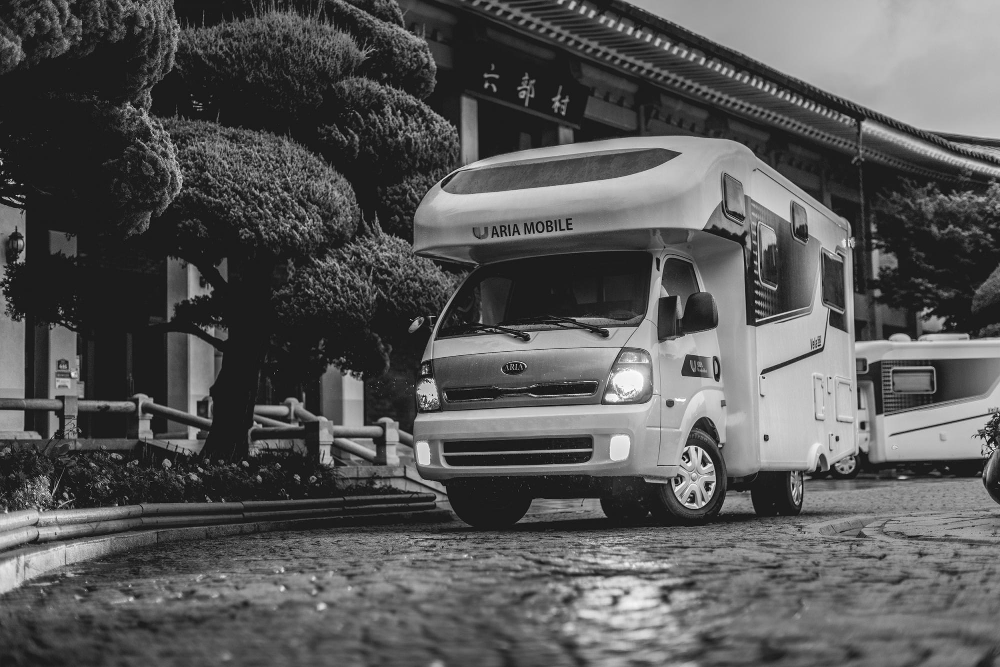

In [26]:
transforms.RandomChoice(transforms_list)(image)

확률적으로 좌우반전 해라

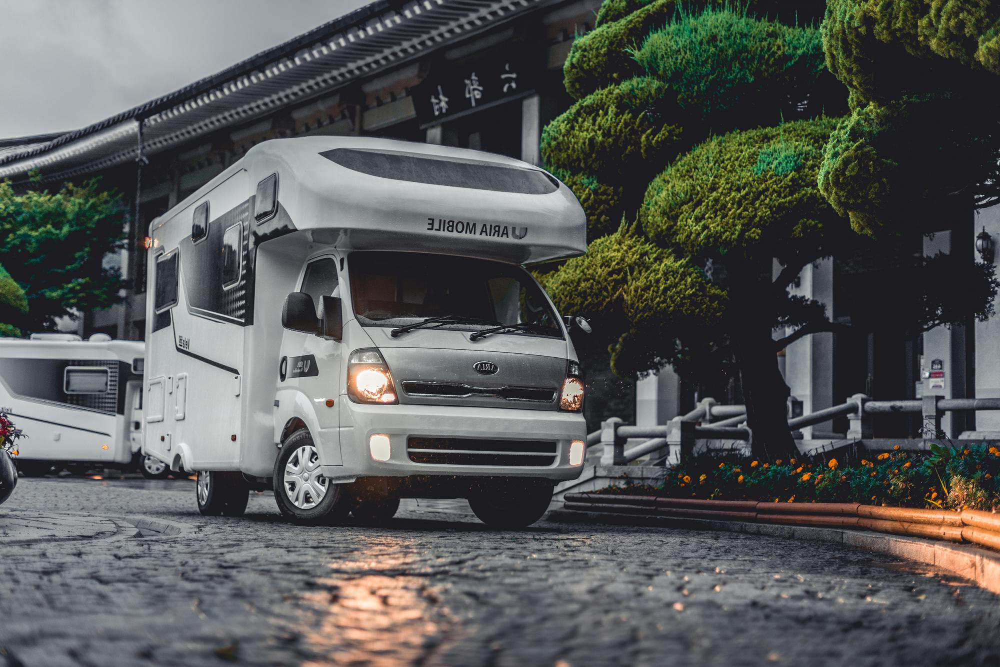

In [30]:
transforms.RandomHorizontalFlip(p=1.0)(image)

### Traning Sample

In [31]:
cifar_dir = '../datasets/cifar/'
train_dir = cifar_dir + 'train'
test_dir = cifar_dir + 'test'

In [32]:
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=1, contrast=0, saturation=0, hue=0),
    transforms.Resize(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) 
])

test_transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) 
])

- 테스트 작업에서는 random 작업을 선호하지 않는다 한다.
    - 테스트 샘플은 곧 실제 필드에 나갔을 때의 상황와 비슷하도록 학습하는 것이 좋으니
    - 랜덤값이 아니라 직접 선정하는 세심한 작업이 요구된다고 한다. 

In [36]:
class Dataset(torch.utils.data.Dataset):
    def __init__(self, data_paths, transform=None):
        super(Dataset).__init__()
        self.data_paths = data_paths
        self.transform = transform
    
    def __len__(self, ):
        return len(self.data_paths)
    
    def __getitem__(self, idx):
        path = self.data_paths[idx]    # 하나의 이미지에 대한 경로
        image = Image.open(path)       # 이미지 오픈
        label_name = path.split('.png')[0].split('_')[-1].strip() # 이미지 이름 : 0_frog.png
        label = label_list.index(label_name)
        
        if self.transform: # 별도의 변환 작업이 있다면
            image = self.transform(image)
        
        return image, label

In [35]:
train_dataset = Dataset(train_paths, transform=train_transform)
train_dataset = Dataset(train_paths, transform=test_transform)

NameError: name 'train_paths' is not defined

In [ ]:
train_dataset = Data

#### 직접 torch.utils.data.Dataset 상속받아서 데이터셋 구현하기

In [2]:
cifar_dir = '../datasets/cifar/'

In [3]:
os.listdir(cifar_dir)

['labels.txt', 'test', 'test_dataset.csv', 'train', 'train_dataset.csv']

In [4]:
train_dir = cifar_dir + 'train'
test_dir = cifar_dir + 'test'

os.listdir(train_dir)[:3], os.listdir(test_dir)[:3]

(['0_frog.png', '10000_automobile.png', '10001_frog.png'],
 ['0_cat.png', '1000_dog.png', '1001_airplane.png'])

text파일 안에 라벨링이 되어있어 불러오는 작업을 해야한다.

In [8]:
os.path.join(cifar_dir, 'labels.txt')

'../datasets/cifar/labels.txt'

In [10]:
label_list = open(os.path.join(cifar_dir, 'labels.txt'), 'r')
label_list.read()

'airplane\nautomobile\nbird\ncat\ndeer\ndog\nfrog\nhorse\nship\ntruck\n'

In [12]:
with open(os.path.join(cifar_dir, 'labels.txt'), 'r') as f:
    label_list = f.read().strip().split('\n')
label_list

['airplane',
 'automobile',
 'bird',
 'cat',
 'deer',
 'dog',
 'frog',
 'horse',
 'ship',
 'truck']

In [13]:
label_list.index('deer')

4

- 불러온 이름라벨들의 인덱스 번호로 숫자라벨을 정해줄 것이다.

In [24]:
train_paths = glob(train_dir + '/*png') # ~~ png로 끝나는 모든 것들
test_paths = glob(test_dir + '/*png') # ~~ png로 끝나는 모든 것들

##### Dataset 클래스 구현

In [33]:
class Dataset(torch.utils.data.Dataset):
    def __init__(self, data_paths, transform=None):
        super(Dataset).__init__()
        self.data_paths = data_paths
        self.transform = transform
    
    def __len__(self, ):
        return len(self.data_paths)
    
    def __getitem__(self, idx):
        path = self.data_paths[idx]    # 하나의 이미지에 대한 경로
        image = Image.open(path)       # 이미지 오픈
        label_name = path.split('.png')[0].split('_')[-1].strip() # 이미지 이름 : 0_frog.png
        label = label_list.index(label_name)
        
        if self.transform: # 별도의 변환 작업이 있다면
            image = self.transform(image)
        
        return image, label
        

##### 디바이스 설정

In [34]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

##### 데이터 로더 설정 (custom data)

In [35]:
batch_size = 32

train_loader = torch.utils.data.DataLoader(
    Dataset(train_paths, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True
)

test_loader = torch.utils.data.DataLoader(
    Dataset(test_paths, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True
)

In [37]:
x, y = next(iter(train_loader))
x.shape, y.shape

(torch.Size([32, 3, 32, 32]), torch.Size([32]))